In [72]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.feature_extraction.text import TfidfVectorizer
import os

# if ' processing_df_.csv' in os.listdir('../data'):
#     print("Partial dataset found!")
#     # use partial or full dataset
#     df_file_name = 'filtered_df_synopsis.csv'
# else:
# use draft dataset
df_file_name = 'training_df.csv'

print(f"Using {df_file_name} as dataset.")
    
try:
    df = pd.read_csv(f'../data/{df_file_name}', low_memory=False)
except FileNotFoundError as e:
    print("File not found. Download the IMDB_Dataset.")
    raise e

pd.options.display.max_columns = None
pd.options.display.max_rows = 100

print(df.columns)
print(df.isnull().sum())
df

Using training_df.csv as dataset.
Index(['Best Picture', 'Certificate (GB)', 'Certificate (US)',
       'Production Companies (1st)', 'Title', 'IMDB Rating', 'genres',
       'plot_keywords', 'genres_encoded', 'production_company_encoded',
       'plot_keywords_encoded', 'genres_decoded', 'production_company_decoded',
       'plot_keywords_decode'],
      dtype='object')
Best Picture                  0
Certificate (GB)              0
Certificate (US)              0
Production Companies (1st)    0
Title                         0
IMDB Rating                   0
genres                        0
plot_keywords                 0
genres_encoded                0
production_company_encoded    0
plot_keywords_encoded         0
genres_decoded                0
production_company_decoded    0
plot_keywords_decode          0
dtype: int64


,Best Picture,Certificate (GB),Certificate (US),Production Companies (1st),Title,IMDB Rating,genres,plot_keywords,genres_encoded,production_company_encoded,plot_keywords_encoded,genres_decoded,production_company_decoded,plot_keywords_decode
0,None,PG,PG,Zanuck/Brown Productions,Cocoon: The Return,5.4,"['Adventure', 'Comedy', 'Mystery', 'Romance', ...",['old'],[ 1 4 15 18 19],8000,[61],['Adventure' 'Comedy' 'Mystery' 'Romance' 'Sci...,Zanuck/Brown Productions,['old']
1,None,15,R,Columbia Pictures,Not Another Teen Movie,5.7,['Comedy'],['past'],[4],2294,[63],['Comedy'],Columbia Pictures,['past']
2,None,PG,PG-13,Metanoia Films,Bella,7.1,"['Drama', 'Romance']","['friend', 'day', 'mysterious', 'past']",[ 7 18],5286,[29 12 58 63],['Drama' 'Romance'],Metanoia Films,['friend' 'day' 'mysterious' 'past']
3,None,None,PG-13,Capstone Pictures,Local Boys,6.6,['Drama'],['new'],[7],1887,[59],['Drama'],Capstone Pictures,['new']
4,None,15,R,Biomorphs Inc.,Guyver: Dark Hero,5.8,"['Action', 'Horror', 'Sci-Fi', 'Thriller']","['discover', 'fight']",[ 0 12 19 21],1349,[15 24],['Action' 'Horror' 'Sci-Fi' 'Thriller'],Biomorphs Inc.,['discover' 'fight']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17662,None,None,Not Rated,Chain Camera Pictures,The Invisible War,7.6,"['Documentary', 'Crime']",['documentary'],[6 5],1993,[17],['Documentary' 'Crime'],Chain Camera Pictures,['documentary']
17663,None,18,R,Filmlink International,The Killing of America,7.6,"['Documentary', 'Crime']","['documentary', 'film']",[6 5],3367,[17 25],['Documentary' 'Crime'],Filmlink International,['documentary' 'film']
17664,None,None,None,Firelight Media Inc.,Jonestown: The Life and Death of Peoples Temple,7.8,"['Documentary', 'History']","['look', 'documentary', 'new']",[ 6 11],3405,[50 17 59],['Documentary' 'History'],Firelight Media Inc.,['look' 'documentary' 'new']
17665,None,15,Not Rated,Public Square Films,How to Survive a Plague,7.6,"['Documentary', 'History', 'News']","['death', 'story', 'group']",[ 6 11 16],6238,[14 79 35],['Documentary' 'History' 'News'],Public Square Films,['death' 'story' 'group']


In [73]:
# import pandas as pd
# from sklearn.preprocessing import MultiLabelBinarizer
# from kmodes.kmodes import KModes
# from prince import MCA
# import matplotlib.pyplot as plt
# import ast

# # Before one-hot encoding, we need to convert the 'genres_decoded' column into a proper list format
# # It appears to be a string representation of lists, so we'll need to parse it

# import ast

# # Function to split concatenated genre strings into a list of individual genres
# def split_genres(genre_string):
#     # Remove surrounding square brackets and split by space
#     return genre_string.strip("[]").replace("'", "").replace(" ", "").split(',')

# # Apply this function to the 'genres_decoded' column
# df['genres_decoded'] = df['genres_decoded'].apply(split_genres)

# # Perform one-hot encoding again
# mlb_genres = MultiLabelBinarizer()
# one_hot_genres = mlb_genres.fit_transform(df['genres_decoded'])
# genres_columns = mlb_genres.classes_
# one_hot_genres_df = pd.DataFrame(one_hot_genres, columns=genres_columns)

# one_hot_genres_df.head()

In [74]:
import ast

# Function to safely convert string to list
def convert_string_to_list(string):
    try:
        return ast.literal_eval(string)
    except (ValueError, SyntaxError):
        return []

# Convert the 'genres' column from string to list
df['genres'] = df['genres'].apply(convert_string_to_list)
df['plot_keywords'] = df['plot_keywords'].apply(convert_string_to_list)

# Extracting all unique genres
unique_genres = set()
for genres_list in df['genres']:
    unique_genres.update(genres_list)

# Convert the set to a sorted list for consistency
unique_genres = sorted(list(unique_genres))

# Extracting all unique genres
unique_keywords = set()
for unique_keywords_list in df['plot_keywords']:
    unique_keywords.update(unique_keywords_list)

# Convert the set to a sorted list for consistency
unique_keywords = sorted(list(unique_keywords))

print(unique_genres)
print(unique_keywords)

['Action', 'Adventure', 'Animation', 'Biography', 'Comedy', 'Crime', 'Documentary', 'Drama', 'Family', 'Fantasy', 'Game-Show', 'History', 'Horror', 'Music', 'Musical', 'Mystery', 'News', 'Reality-TV', 'Romance', 'Sci-Fi', 'Sport', 'Thriller', 'War', 'Western']
['agent', 'american', 'begins', 'best', 'boy', 'brother', 'city', 'college', 'comes', 'couple', 'crime', 'daughter', 'day', 'dead', 'death', 'discover', 'discovers', 'documentary', 'drug', 'evil', 'ex', 'falls', 'family', 'father', 'fight', 'film', 'finds', 'follows', 'forced', 'friend', 'friends', 'future', 'gets', 'girl', 'goes', 'group', 'help', 'high', 'home', 'house', 'husband', 'job', 'journey', 'just', 'killer', 'life', 'lives', 'living', 'local', 'long', 'look', 'love', 'make', 'man', 'meets', 'men', 'mother', 'murder', 'mysterious', 'new', 'night', 'old', 'order', 'past', 'people', 'police', 'prison', 'real', 'relationship', 'returns', 'run', 'save', 'school', 'secret', 'set', 'small', 'son', 'soon', 'stop', 'story', 'st

In [79]:
import pandas as pd
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

# One-hot encode genres
mlb_genres = MultiLabelBinarizer()
genres_encoded = mlb_genres.fit_transform(df['genres'])

# One-hot encode plot keywords
mlb_keywords = MultiLabelBinarizer()
keywords_encoded = mlb_keywords.fit_transform(df['plot_keywords'])

# Combine genres and plot keywords features
combined_features = np.hstack((genres_encoded, keywords_encoded))

# Compute cosine similarity
similarity_matrix = cosine_similarity(combined_features)

# Convert similarity matrix to a DataFrame for better readability
similarity_df = pd.DataFrame(similarity_matrix, index=df['Title'], columns=df['Title'])

similarity_df

Title,Cocoon: The Return,Not Another Teen Movie,Bella,Local Boys,Guyver: Dark Hero,The Guyver,Drive,Black Sheep,Snow Falling on Cedars,The Long Walk Home,The Journey of August King,Black Mirror: Bandersnatch,Psychos in Love,The Search for One-eye Jimmy,FleshEater,Day of the Dead,The Secret Agent Club,Jimmy P: Psychotherapy of a Plains Indian,Tapeheads,Luther the Geek,Eddie,Maria's Lovers,Killer Tomatoes Strike Back!,Little,The Public,Cats,Kurt Cobain About a Son,Dear John,Off Limits,The Next Best Thing,Dirty Dancing,Singles,Miss March,Cradle 2 the Grave,Don't Sleep,Blackrock,Deadly Cuts,Happy Feet Two,Texas Rangers,All Day and a Night,Christmas Carol: The Movie,Drumline,Wild Style,Skipped Parts,A Private War,Attack of the 50 Foot Cheerleader,Hotel for the Holidays,The Harder They Fall,A California Christmas,Intruder,Cabin Fever,40 Days and 40 Nights,The Water Man,Extraction,Extreme Movie,The Best of Times,Phineas and Ferb the Movie: Candace Against the Universe,The Soccer Football Movie,Halloween II,Naked Gun 33 1/3: The Final Insult,The Naked Gun 2½: The Smell of Fear,Weird: The Al Yankovic Story,Sandy Wexler,The Naked Gun: From the Files of Police Squad!,UHF,The Challenge,Land of the Lost,Lost Angels,Rancid Aluminum,Goodbye Charlie Bright,Like It Is,What We Left Behind: Looking Back at Star Trek: Deep Space Nine,Spontaneous Combustion,The Marrying Man,Explorers,Night Patrol,Defending Your Life,Cloud 9,Trading Places,Duets,Friday After Next,Married to the Mob,Ricki and the Flash,Hardball,Submergence,Finding Dory,Sing 2,Rim of the World,The Grinch,Legion of the Dead,Down in the Valley,The Retaliators,The Informer,Entergalactic,Vox Lux,The Hunted,King Corn,Glitter,New Waterford Girl,Class,Napoleon Dynamite,Tenet,Anna Karenina,Outlaw King,Dating Amber,Albert Nobbs,Chatroom,Avengers: Age of Ultron,The Illusionist,Nocturnal Animals,Bullet Train,Shanghai Knights,Savages,"Angus, Thongs and Perfect Snogging",The Greatest,Tom & Thomas,The Thief Lord,Nowhere Boy,A Million Little Pieces,The Wall,Godzilla,Kick-Ass,Kick-Ass 2,The Maze,Ambulance,She-Devil,What's Cooking?,Beyond the Limit,Curse of Chucky,California Solo,Powwow Highway,Stop! Or My Mom Will Shoot,Halloween: The Curse of Michael Myers,Trailer Park Boys,Clerks,Passing,Stardust Memories,Judy Berlin,Celebrity,Stranger Than Paradise,The Man Who Wasn't There,The Addiction,Running Time,Ed Wood,Down by Law,Pi,Archangel,The American Astronaut,A Midwinter's Tale,Set Fire to the Stars,The General,Control,Twenty Four Seven,Following,The Hebrew Hammer,The Dark Backward,Brother to Brother,Family Viewing,American Gun,Eve's Bayou,Beefcake,The Chosen,Lorenzo's Oil,Piñero,Standing in the Shadows of Motown,The Lemon Sisters,Billy's Hollywood Screen Kiss,She's Gotta Have It,Last Dance,9,Penn & Teller Get Killed,The Prophecy,Killer: A Journal of Murder,Pleasantville,Great Balls of Fire!,Hard Core Logo,Forbidden Zone,Hammett,Cutter's Way,Brenda Starr,There Goes the Neighborhood,Poison,Throw Momma from the Train,Trial by Jury,A Different Loyalty,The Blue Elephant,The Faith of Anna Waters,The Inner Circle,September 11,Stardom,Lisbon Story,The Shooting Party,Enigma,Deserter,Wisconsin Death Trip,The Nine Lives of Tomas Katz,The Raspberry Reich,Rain,Swimming Upstream,"No Retreat, No Surrender 2",The Secret Life of Nikola Tesla,Bagdad Cafe,Piccadilly Jim,Ratchet & Clank,Adrift,Hollywood.Con,Who Am I?,Teenage Mutant Ninja Turtles II: The Secret of the Ooze,Rush Hour 2,Making Contact,"No Retreat, No Surrender 3: Blood Brothers",Patriots Day,The King of the Kickboxers,Naked Weapon,We Will Be the World Champions,The Medallion,Lili Marleen,Black Mask 2: City of Masks,The Cannonball Run,Southpaw,The Protector,Moon 44,Bad Black,The Good Lie,The Lullaby,Hellgate,Taking Earth,Samson,Material,White Lion,The Mangler,Nukie,Seal Team,Khumba,Prey,Fried Barry,Kite,Eye in the Sky,Demonoid,Don't Panic,Amityville II: The Possession,Bardo: False Chronicle of a Handful of Truths,Everybody Loves Somebody,Ana and Bruno,The B

In [80]:
from sklearn.cluster import KMeans

# Continuing from the previous example where 'combined_features' is defined

# Apply KMeans clustering
n_clusters = 5  # You can choose the number of clusters
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(combined_features)

# Assign cluster labels to each movie
df['Cluster'] = kmeans.labels_

# Display the DataFrame with cluster labels
print(df)


AttributeError: 'NoneType' object has no attribute 'split'

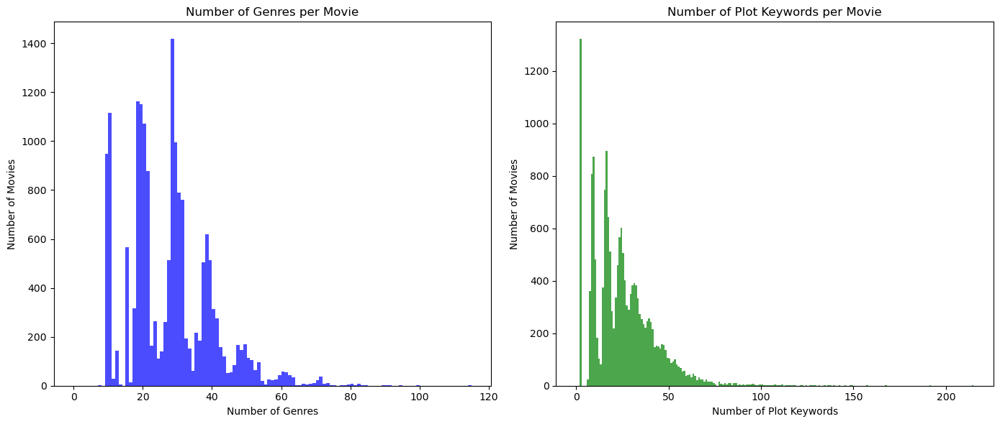

In [76]:
import matplotlib.pyplot as plt

# Calculate the number of genres and plot keywords per movie
num_genres_per_movie = df['genres_decoded'].apply(len)
num_keywords_per_movie = df['plot_keywords_decode'].apply(len)

# Plotting
plt.figure(figsize=(14, 6))

# Histogram for genres
plt.subplot(1, 2, 1)
plt.hist(num_genres_per_movie, bins=range(0, num_genres_per_movie.max()+1), color='blue', alpha=0.7)
plt.title('Number of Genres per Movie')
plt.xlabel('Number of Genres')
plt.ylabel('Number of Movies')

# Histogram for plot keywords
plt.subplot(1, 2, 2)
plt.hist(num_keywords_per_movie, bins=range(0, num_keywords_per_movie.max()+1), color='green', alpha=0.7)
plt.title('Number of Plot Keywords per Movie')
plt.xlabel('Number of Plot Keywords')
plt.ylabel('Number of Movies')

plt.tight_layout()
plt.show()